In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
 
%matplotlib inline

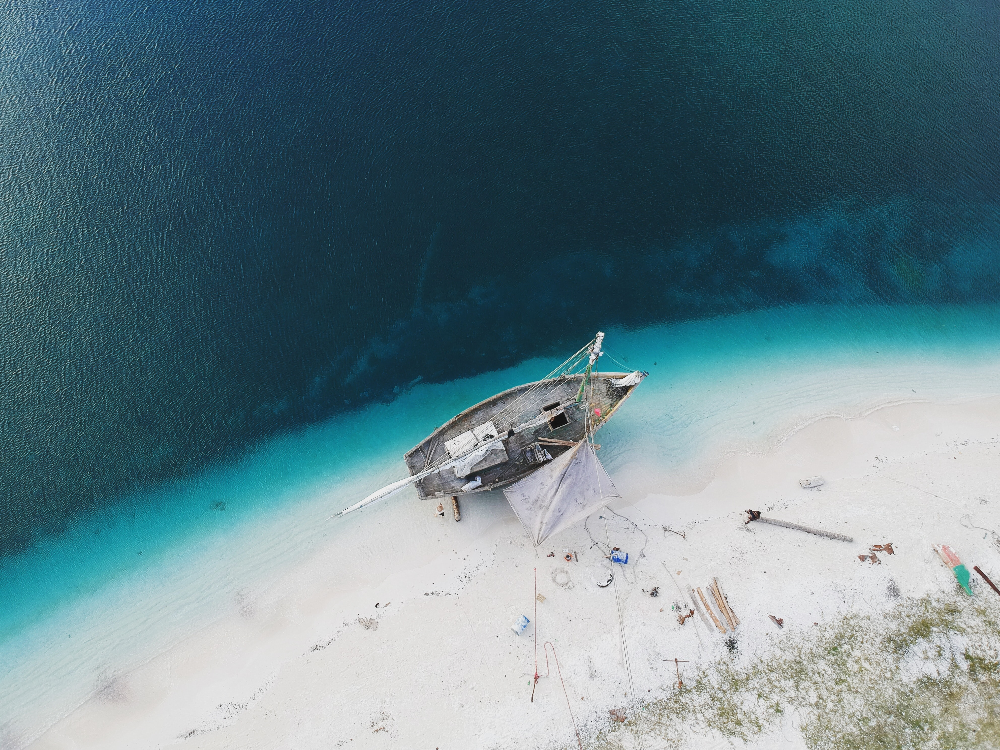

In [ ]:
image = cv2.imread('/content/drive/MyDrive/Source/caleb-george-AtvuPUenaeI-unsplash.jpg')
#print(image) To check the correctness of theuploaded image
from google.colab.patches import cv2_imshow
cv2_imshow(image)

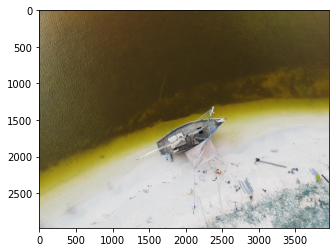

In [ ]:
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#cv2_imshow(image)
plt.imshow(image)

Reshaping the image into a 2D array of pixels and 3 color values (RGB)

In [ ]:
pixel_vals = image.reshape((-1,3))

Convert to float type

In [ ]:
pixel_vals = np.float32(pixel_vals)

Criteria for the algorithm to stop running, which will happen is 100 iterations are run or the epsilon (which is the required accuracy) becomes 85%

In [ ]:
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.85)

Perfrom K means clustering with Random centers

In [ ]:
k = 3
retval, labels, centers = cv2.kmeans(pixel_vals, k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)

Convert data into 8-bit values and reshape data into the original image dimensions

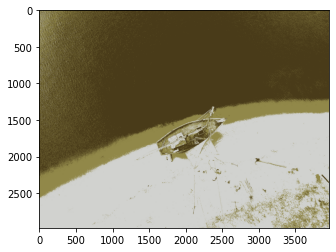

In [ ]:
centers = np.uint8(centers)
segmented_data = centers[labels.flatten()]
 
segmented_image = segmented_data.reshape((image.shape))
 
plt.imshow(segmented_image)

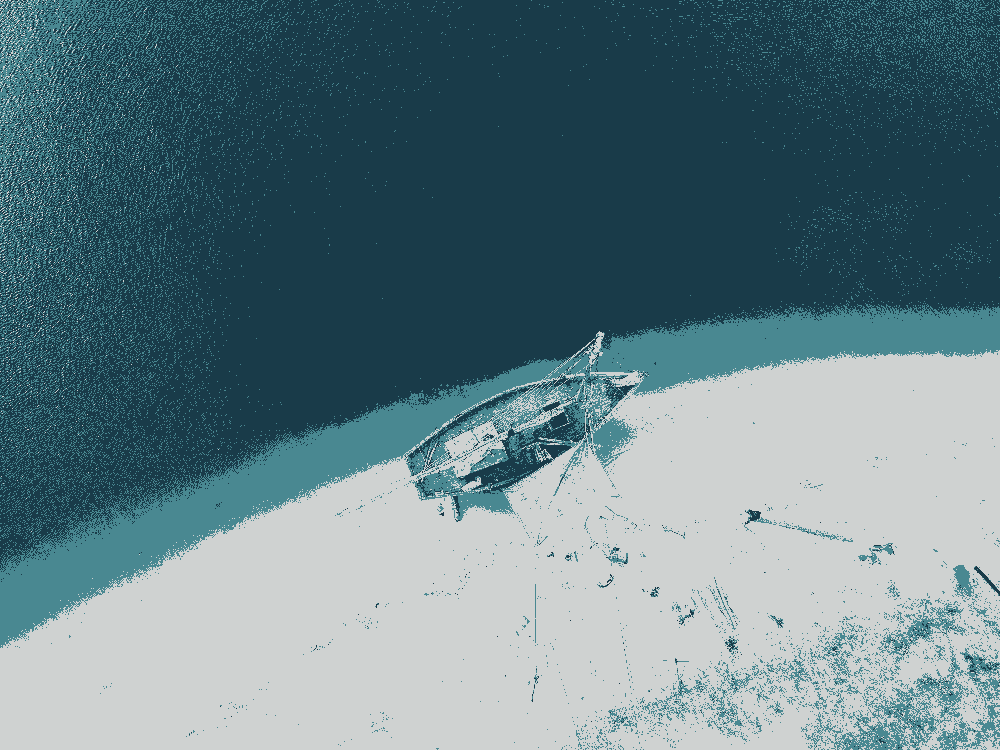

In [ ]:
cv2_imshow(segmented_image)

AIM : To Seggregate Prominent Colors from an image with their
outlines in a picture

DESCRIPTION : This project uses K Means Clustering to seggregate prominent colors of an image with their outlines. K-means clustering uses “centroids”, K different randomly-initiated points in the data, and assigns every data point to the nearest centroid. After every point has been assigned, the centroid is moved to the average of all of the points assigned to it.

Basically, it marks the most prominent pixel or group of pixels of the most prominent color as a centroid and takes into account all the other surrounding pixels with almost the same color and highlights them with a color value which is average of the centroid and those pixels

![image](https://www.learnbymarketing.com/wp-content/uploads/2015/01/method-k-means-steps-example.png)

It converges the rest of the pixels into the same color until it can no longer be converged. Those are your most prominent color shades in the picture

SOME INFO ABOUT K MEANS CLUSTERING : K-Means Clustering is an Unsupervised Learning algorithm, which groups the unlabeled dataset into different clusters. Here K defines the number of pre-defined clusters that need to be created in the process, as if K=2, there will be two clusters, and for K=3, there will be three clusters, and so on. It allows us to cluster the data into different groups and a convenient way to discover the categories of groups in the unlabeled dataset on its own without the need for any training.

It is a centroid-based algorithm, where each cluster is associated with a centroid. The main aim of this algorithm is to minimize the sum of distances between the data point and their corresponding clusters.